<a href="https://colab.research.google.com/github/dhanushrii/music_generation/blob/main/Music_generation.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [10]:
!pip install torch music21

In [11]:
!pip install requests tqdm music21


In [12]:
import pathlib
import requests
from tqdm import tqdm
import zipfile
import glob
import os

data_dir = pathlib.Path('data/maestro-v2.0.0')

def download_and_extract_maestro(url, extract_to):
    zip_file = f"{extract_to}.zip"

    os.makedirs(extract_to.parent, exist_ok=True)

    if not pathlib.Path(zip_file).exists():
        response = requests.get(url, stream=True)
        total_size = int(response.headers.get('content-length', 0))
        block_size = 1024

        with open(zip_file, 'wb') as file, tqdm(
            desc="Downloading MAESTRO dataset",
            total=total_size, unit='iB', unit_scale=True
        ) as bar:
            for data in response.iter_content(block_size):
                bar.update(len(data))
                file.write(data)

    if not extract_to.exists():
        with zipfile.ZipFile(zip_file, 'r') as zip_ref:
            zip_ref.extractall(extract_to)
        print(f"Extraction completed: {extract_to}")

if not data_dir.exists():
    maestro_url = 'https://storage.googleapis.com/magentadata/datasets/maestro/v2.0.0/maestro-v2.0.0-midi.zip'
    download_and_extract_maestro(maestro_url, data_dir)

files = glob.glob(str(data_dir/'**/*.mid*'), recursive=True)
print('Number of files found:', len(files))

for file in files[:5]:
    print(file)


Number of files found: 1282
data/maestro-v2.0.0/maestro-v2.0.0/2015/MIDI-Unprocessed_R1_D1-9-12_mid--AUDIO-from_mp3_12_R1_2015_wav--3.midi
data/maestro-v2.0.0/maestro-v2.0.0/2015/MIDI-Unprocessed_R1_D1-1-8_mid--AUDIO-from_mp3_03_R1_2015_wav--2.midi
data/maestro-v2.0.0/maestro-v2.0.0/2015/MIDI-Unprocessed_R2_D2-12-13-15_mid--AUDIO-from_mp3_15_R2_2015_wav--1.midi
data/maestro-v2.0.0/maestro-v2.0.0/2015/MIDI-Unprocessed_R1_D1-1-8_mid--AUDIO-from_mp3_04_R1_2015_wav--2.midi
data/maestro-v2.0.0/maestro-v2.0.0/2015/MIDI-Unprocessed_R2_D2-12-13-15_mid--AUDIO-from_mp3_15_R2_2015_wav--3.midi


In [13]:
print('Number of files found:', len(files))

Number of files found: 1282


In [14]:
import time
from music21 import converter, instrument, note, chord

def preprocess_notes(files):
    notes = []
    file_count = len(files)

    for idx, midi_file in enumerate(files[:10]):
        print(f"Processing file {idx+1}/{file_count}: {midi_file}")
        start_time = time.time()

        try:
            midi = converter.parse(midi_file)
            notes_to_parse = None

            parts = instrument.partitionByInstrument(midi)
            if parts:
                notes_to_parse = parts.parts[0].recurse()
            else:
                notes_to_parse = midi.flat.notes

            for element in notes_to_parse:
                if isinstance(element, note.Note):
                    notes.append(str(element.pitch))
                elif isinstance(element, chord.Chord):
                    notes.append('.'.join(str(n) for n in element.normalOrder))

        except Exception as e:
            print(f"Error processing {midi_file}: {e}")

        print(f"Finished processing {midi_file} in {time.time() - start_time:.2f} seconds\n")
    return notes

files = glob.glob(str(data_dir / '**/*.mid*'), recursive=True)
notes = preprocess_notes(files)

print(f"Total notes parsed: {len(notes)}")


Processing file 1/1282: data/maestro-v2.0.0/maestro-v2.0.0/2015/MIDI-Unprocessed_R1_D1-9-12_mid--AUDIO-from_mp3_12_R1_2015_wav--3.midi
Finished processing data/maestro-v2.0.0/maestro-v2.0.0/2015/MIDI-Unprocessed_R1_D1-9-12_mid--AUDIO-from_mp3_12_R1_2015_wav--3.midi in 0.72 seconds

Processing file 2/1282: data/maestro-v2.0.0/maestro-v2.0.0/2015/MIDI-Unprocessed_R1_D1-1-8_mid--AUDIO-from_mp3_03_R1_2015_wav--2.midi
Finished processing data/maestro-v2.0.0/maestro-v2.0.0/2015/MIDI-Unprocessed_R1_D1-1-8_mid--AUDIO-from_mp3_03_R1_2015_wav--2.midi in 0.20 seconds

Processing file 3/1282: data/maestro-v2.0.0/maestro-v2.0.0/2015/MIDI-Unprocessed_R2_D2-12-13-15_mid--AUDIO-from_mp3_15_R2_2015_wav--1.midi
Finished processing data/maestro-v2.0.0/maestro-v2.0.0/2015/MIDI-Unprocessed_R2_D2-12-13-15_mid--AUDIO-from_mp3_15_R2_2015_wav--1.midi in 0.96 seconds

Processing file 4/1282: data/maestro-v2.0.0/maestro-v2.0.0/2015/MIDI-Unprocessed_R1_D1-1-8_mid--AUDIO-from_mp3_04_R1_2015_wav--2.midi
Finished pr

In [15]:
sequence_length = 100
import numpy as np

unique_notes = sorted(list(set(notes)))
n_vocab = len(unique_notes)

note_to_int = {note: number for number, note in enumerate(unique_notes)}

network_input = []
network_output = []

for i in range(len(notes) - sequence_length):
    seq_in = notes[i:i + sequence_length]
    seq_out = notes[i + sequence_length]
    network_input.append([note_to_int[note] for note in seq_in])
    network_output.append(note_to_int[seq_out])

n_patterns = len(network_input)

network_input = np.reshape(network_input, (n_patterns, sequence_length, 1))
network_input = network_input / float(n_vocab)
network_output = np.array(network_output)


In [16]:
import torch
import torch.nn as nn
import torch.optim as optim

class MusicLSTM(nn.Module):
    def __init__(self, input_size, hidden_size, output_size, num_layers):
        super(MusicLSTM, self).__init__()
        self.hidden_size = hidden_size
        self.num_layers = num_layers
        self.lstm = nn.LSTM(input_size, hidden_size, num_layers, batch_first=True)
        self.fc = nn.Linear(hidden_size, output_size)

    def forward(self, x):
        h0 = torch.zeros(self.num_layers, x.size(0), self.hidden_size).to(x.device)
        c0 = torch.zeros(self.num_layers, x.size(0), self.hidden_size).to(x.device)
        out, _ = self.lstm(x, (h0, c0))
        out = self.fc(out[:, -1, :])
        return out

input_size = 1
hidden_size = 512
output_size = n_vocab
num_layers = 2

model = MusicLSTM(input_size, hidden_size, output_size, num_layers)
criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr=0.001)

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model.to(device)


MusicLSTM(
  (lstm): LSTM(1, 512, num_layers=2, batch_first=True)
  (fc): Linear(in_features=512, out_features=612, bias=True)
)

Epoch 1/50, Training Loss: 5.0912, Training Accuracy: 2.34%
Epoch 2/50, Training Loss: 5.0656, Training Accuracy: 2.34%
Epoch 3/50, Training Loss: 4.9730, Training Accuracy: 2.77%
Epoch 4/50, Training Loss: 4.8720, Training Accuracy: 2.98%
Epoch 5/50, Training Loss: 4.8557, Training Accuracy: 2.88%
Epoch 6/50, Training Loss: 4.8278, Training Accuracy: 3.14%
Epoch 7/50, Training Loss: 4.8260, Training Accuracy: 3.18%
Epoch 8/50, Training Loss: 4.7958, Training Accuracy: 3.26%
Epoch 9/50, Training Loss: 4.7965, Training Accuracy: 3.33%
Epoch 10/50, Training Loss: 4.7685, Training Accuracy: 3.39%
Epoch 11/50, Training Loss: 4.7423, Training Accuracy: 3.67%
Epoch 12/50, Training Loss: 4.7373, Training Accuracy: 3.85%
Epoch 13/50, Training Loss: 4.6737, Training Accuracy: 4.12%
Epoch 14/50, Training Loss: 4.6425, Training Accuracy: 4.38%
Epoch 15/50, Training Loss: 4.6207, Training Accuracy: 4.71%
Epoch 16/50, Training Loss: 4.5366, Training Accuracy: 5.18%
Epoch 17/50, Training Loss: 4.447

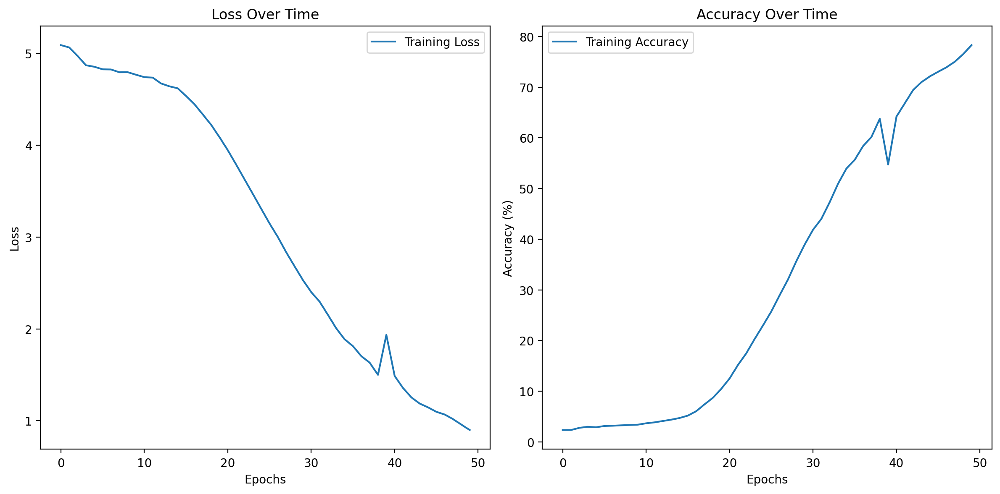

In [9]:
import torch
import matplotlib.pyplot as plt
from torch.utils.data import DataLoader, TensorDataset, random_split

train_size = int(0.8 * len(network_input))
val_size = len(network_input) - train_size

train_input, val_input = torch.Tensor(network_input[:train_size]), torch.Tensor(network_input[train_size:])
train_output, val_output = torch.LongTensor(network_output[:train_size]), torch.LongTensor(network_output[train_size:])

train_input = train_input.to(device)
train_output = train_output.to(device)

val_input = val_input.to(device)
val_output = val_output.to(device)

train_data = TensorDataset(train_input, train_output)
val_data = TensorDataset(val_input, val_output)

train_loader = DataLoader(train_data, batch_size=64, shuffle=True)
val_loader = DataLoader(val_data, batch_size=64, shuffle=False)

# Train the model
epochs = 50
train_losses = []  # List to store training loss for each epoch
train_accuracies = []  # List to store training accuracy for each epoch
val_losses = []  # List to store validation loss for each epoch
val_accuracies = []  # List to store validation accuracy for each epoch

for epoch in range(epochs):
    # Training phase
    model.train()
    running_loss = 0.0
    correct_preds = 0  # For accuracy calculation
    total_preds = 0

    for inputs, targets in train_loader:
        optimizer.zero_grad()

        # Forward pass
        outputs = model(inputs)

        # Compute loss
        loss = criterion(outputs, targets)

        # Backward pass and optimization
        loss.backward()
        optimizer.step()

        # Track the running loss
        running_loss += loss.item()

        # Compute accuracy
        _, predicted = torch.max(outputs, 1)
        correct_preds += (predicted == targets).sum().item()
        total_preds += targets.size(0)
    avg_loss = running_loss / len(train_loader)
    train_losses.append(avg_loss)

    accuracy = correct_preds / total_preds * 100
    train_accuracies.append(accuracy)

    model.eval()
    val_running_loss = 0.0
    val_correct_preds = 0
    val_total_preds = 0

    with torch.no_grad():
        for inputs, targets in val_loader:
            outputs = model(inputs)

            val_loss = criterion(outputs, targets)
            val_running_loss += val_loss.item()

            _, val_predicted = torch.max(outputs, 1)
            val_correct_preds += (val_predicted == targets).sum().item()
            val_total_preds += targets.size(0)

    val_avg_loss = val_running_loss / len(val_loader)
    val_losses.append(val_avg_loss)

    val_accuracy = val_correct_preds / val_total_preds * 100
    val_accuracies.append(val_accuracy)

    print(f"Epoch {epoch + 1}/{epochs}, "
          f"Training Loss: {avg_loss:.4f}, Training Accuracy: {accuracy:.2f}%")

plt.figure(figsize=(12, 6))

plt.subplot(1, 2, 1)
plt.plot(train_losses, label='Training Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.title('Loss Over Time')
plt.legend()

plt.subplot(1, 2, 2)
plt.plot(train_accuracies, label='Training Accuracy')
plt.xlabel('Epochs')
plt.ylabel('Accuracy (%)')
plt.title('Accuracy Over Time')
plt.legend()

plt.tight_layout()
plt.show()


In [17]:

def generate_notes(model, start_sequence, num_notes):
    model.eval()
    int_to_note = {number: note for note, number in note_to_int.items()}
    pattern = [note_to_int[note] for note in start_sequence]
    generated_notes = []

    for i in range(num_notes):
        input_sequence = np.reshape(pattern, (1, len(pattern), 1))
        input_sequence = torch.Tensor(input_sequence / float(n_vocab)).to(device)

        prediction = model(input_sequence)
        predicted_note = torch.argmax(prediction, dim=1).item()
        generated_notes.append(int_to_note[predicted_note])

        pattern.append(predicted_note)
        pattern = pattern[1:]

    return generated_notes

start_sequence = notes[:sequence_length]
generated_notes = generate_notes(model, start_sequence, 500)


In [19]:
!pip install music21 midi2audio
!apt-get install fluidsynth


Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
fluidsynth is already the newest version (2.2.5-1).
0 upgraded, 0 newly installed, 0 to remove and 34 not upgraded.


In [20]:
from music21 import stream, note, instrument, chord
from midi2audio import FluidSynth
from IPython.display import Audio

def create_midi_from_notes(generated_notes, output_path='output.mid'):
    offset = 0
    output_notes = []

    for pattern in generated_notes:
        # If it's a chord (e.g., '2.5.8')
        if '.' in pattern or pattern.isdigit() == False:
            notes_in_chord = [int(n) for n in pattern.split('.') if n.isdigit()]
            new_chord = chord.Chord(notes_in_chord)
            new_chord.offset = offset
            new_chord.storedInstrument = instrument.Piano()
            output_notes.append(new_chord)
        else:
            new_note = note.Note(int(pattern))
            new_note.offset = offset
            new_note.storedInstrument = instrument.Piano()
            output_notes.append(new_note)

        offset += 0.5

    midi_stream = stream.Stream(output_notes)
    midi_stream.write('midi', fp=output_path)

create_midi_from_notes(generated_notes, output_path='output.mid')

fs = FluidSynth()
midi_file = 'output.mid'
wav_file = 'output.wav'
fs.midi_to_audio(midi_file, wav_file)

Audio(wav_file)
